In [ ]:
#### Surprisal component analysis for RNA preprocessing ####

import scanpy as sc
from shannonca.dimred import reduce_scanpy
import numpy as np
import anndata as ad
import pandas as pd
np.random.seed(567)

# set up directories
import os
work_dir = '/Scottbrowne/members/smd/Projects/SD031/scenicplus/B16_CART'
data_dir = '/Scottbrowne/seq/tmp/devoes/SD031'
if not os.path.exists(os.path.join(work_dir, 'RNA')):
    os.makedirs(os.path.join(work_dir, 'RNA'))

# adjust figure paramters to look nice
import scanpy as sc
%matplotlib inline
sc.settings.set_figure_params(dpi=80, frameon=False,figsize=(5,5), facecolor='white') # set dpi higher? 300?

In [ ]:
# load 10x matrix
# GSE202543_B16_CART_tumor

adata = sc.read_10x_h5(os.path.join(data_dir,
                                    'GSE202543/B16_CAR_T_D7_Tumor/cellranger-arc_outs/GSE202543_B16_CAR_T_D7_Tumor/outs/filtered_feature_bc_matrix.h5'))
adata.var_names_make_unique()
adata.obs_names_make_unique()

adata

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/anndata/_core/anndata.py:1840: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


AnnData object with n_obs × n_vars = 16427 × 32285
    var: 'gene_ids', 'feature_types', 'genome'

In [ ]:
# calc QC metrics
adata.var['mt'] = adata.var_names.str.startswith('mt-') # mouse mito genes are mt, human is MT
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt',], percent_top=None, log1p=False, inplace=True)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


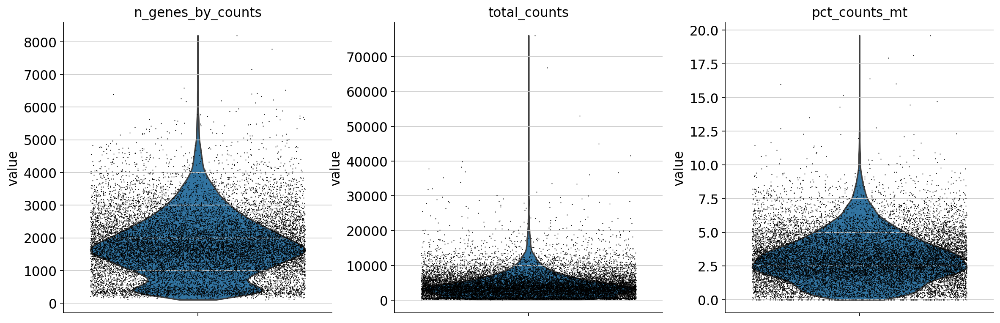

In [ ]:
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)

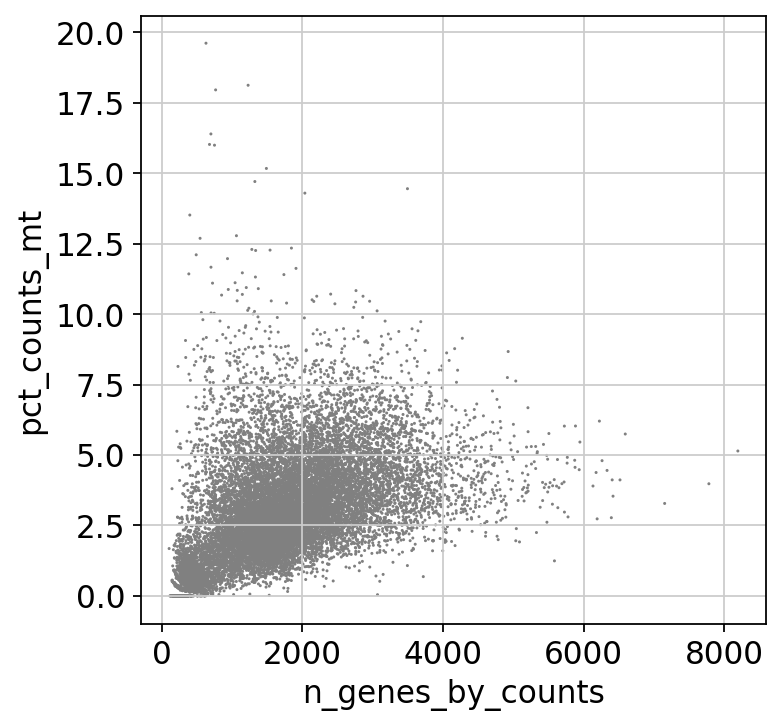

In [ ]:
sc.pl.scatter(adata, "n_genes_by_counts", "pct_counts_mt")

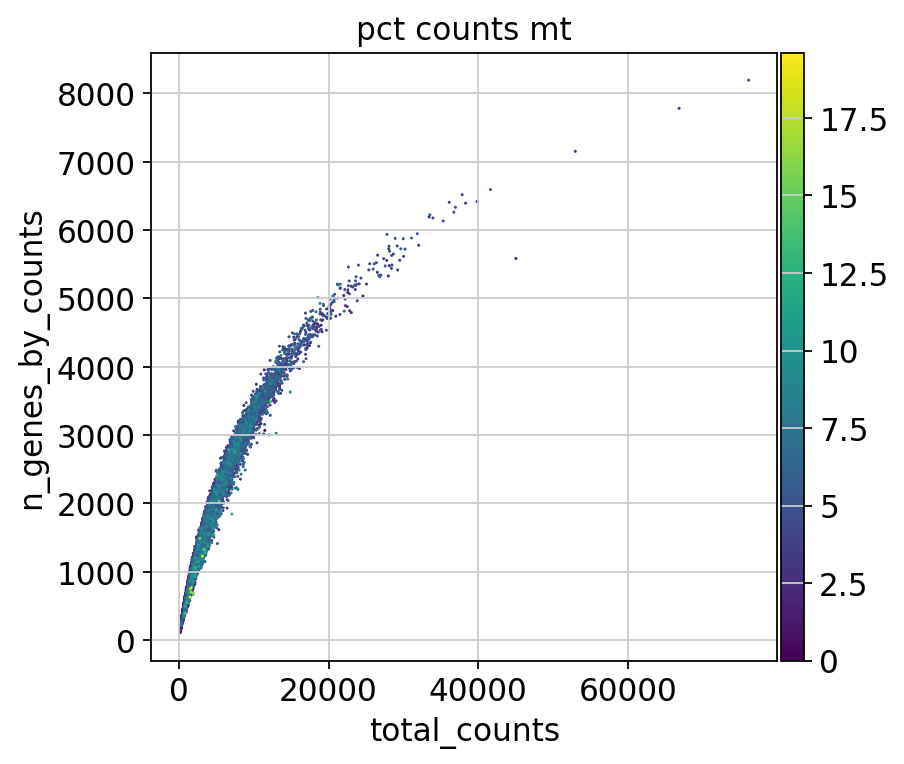

In [ ]:
sc.pl.scatter(adata, "total_counts", "n_genes_by_counts", color="pct_counts_mt")

In [ ]:
# define filtering criteria
n_counts_filter_max = 4500
mito_filter = 10
n_counts_filter_min = 500
min_cell_filter = 5

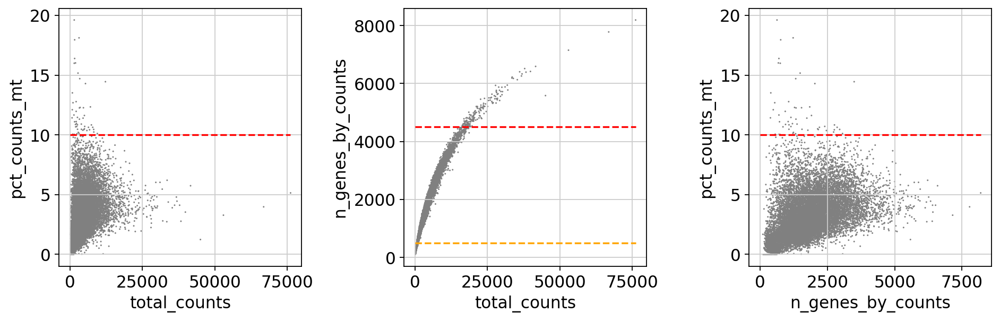

In [ ]:
import matplotlib.pyplot as plt
fig, axs = plt.subplots(ncols = 3, figsize = (12,4))
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt', ax = axs[0], show=False)
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts', ax = axs[1], show = False)
sc.pl.scatter(adata, x='n_genes_by_counts', y='pct_counts_mt', ax = axs[2], show = False)
#draw horizontal red lines indicating thresholds.
axs[0].hlines(y = mito_filter, xmin = 0, xmax = max(adata.obs['total_counts']), color = 'red', ls = 'dashed')
axs[1].hlines(y = n_counts_filter_max, xmin = 0, xmax = max(adata.obs['total_counts']), color = 'red', ls = 'dashed')
axs[1].hlines(y = n_counts_filter_min, xmin = 0, xmax = max(adata.obs['total_counts']), color = 'orange', ls = 'dashed')
axs[2].hlines(y = mito_filter, xmin = 0, xmax = max(adata.obs['n_genes_by_counts']), color = 'red', ls = 'dashed')
fig.tight_layout()
plt.show()

In [ ]:
# filter cells and genes
sc.pp.filter_cells(adata, min_genes=n_counts_filter_min)
sc.pp.filter_cells(adata, max_genes=n_counts_filter_max)
sc.pp.filter_genes(adata, min_cells=min_cell_filter)
adata = adata[adata.obs.pct_counts_mt < mito_filter, :]

# estimate and remove doublets
sc.external.pp.scrublet(adata)
adata = adata[adata.obs['predicted_doublet'] == False] #do the actual filtering

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/preprocessing/_normalization.py:169: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


Automatically set threshold at doublet score = 0.47
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 0.0%
Overall doublet rate:
	Expected   = 5.0%
	Estimated  = 33.3%


/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/external/pp/_scrublet.py:271: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['doublet_score'] = scrubbed['obs']['doublet_score']


In [ ]:
# save raw data in .raw slot for later use in SCENIC+
adata.raw=adata

In [ ]:
# normalize 10X GEX
sc.pp.normalize_total(adata, target_sum=1e4)
# log transform ( counts + 1 )
sc.pp.log1p(adata)
# scale - all genes will have same "weight"/sway in the reduction (means set at 0 with unit variance)
sc.pp.scale(adata)

In [ ]:
# run SCA for 5 iterations to produce a 50-dimensional embedding
reduce_scanpy(adata, n_comps=50, iters=5, keep_scores=True, keep_loadings=True)
adata.obsm['X_sca'].shape

iteration 1
iteration 2
iteration 3
iteration 4
iteration 5


(14520, 50)

In [ ]:
sc.pp.neighbors(adata, use_rep = 'X_sca', n_pcs = 50, n_neighbors = 10)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/umap/distances.py:1063: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/umap/distances.py:1071: NumbaDeprecationWarning: The 'nopython' keyword argument was not supplied to the 'numba.jit' decorator. The implicit default value for this argument is currently False, but it will be changed to True in Numba 0.59.0. See https://numba.readthedocs.io/en/stable/reference/deprecation.html#deprecation-of-object-mode-fall-back-behaviour-when-using-jit for details.
  @numba.jit()
/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/pyth

In [ ]:
# non-linear dimension reduction - compute umap
sc.tl.umap(adata, min_dist = 0.2, spread = 1)

In [ ]:
# cluster
import leidenalg
sc.tl.leiden(adata,resolution = 0.9) # 0.85
adata.obs['leiden'].value_counts()

0     2357
1     2305
2     1638
3     1464
4     1112
5     1033
6      904
7      865
8      779
9      731
10     511
11     400
12     199
13     161
14      61
Name: leiden, dtype: int64

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


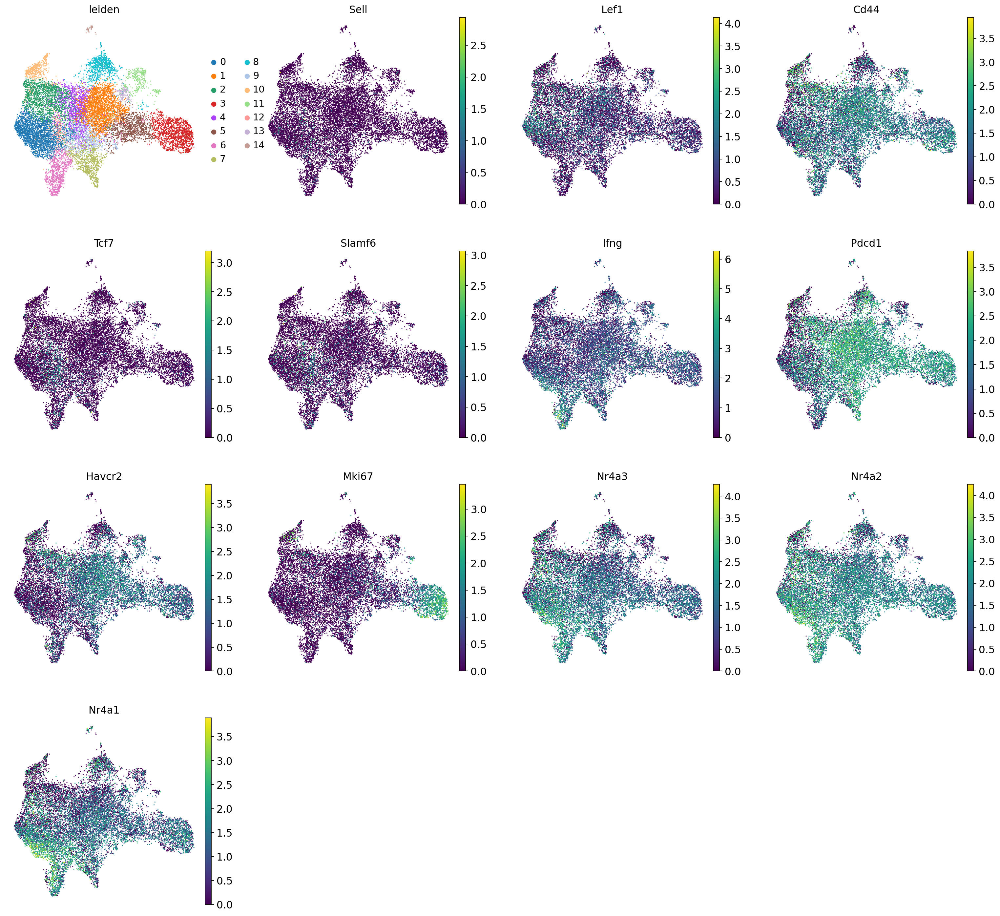

In [ ]:
sc.pl.umap(adata, color = ['leiden','Sell','Lef1','Cd44','Tcf7','Slamf6','Ifng','Pdcd1','Havcr2','Mki67','Nr4a3','Nr4a2','Nr4a1'], use_raw=True)

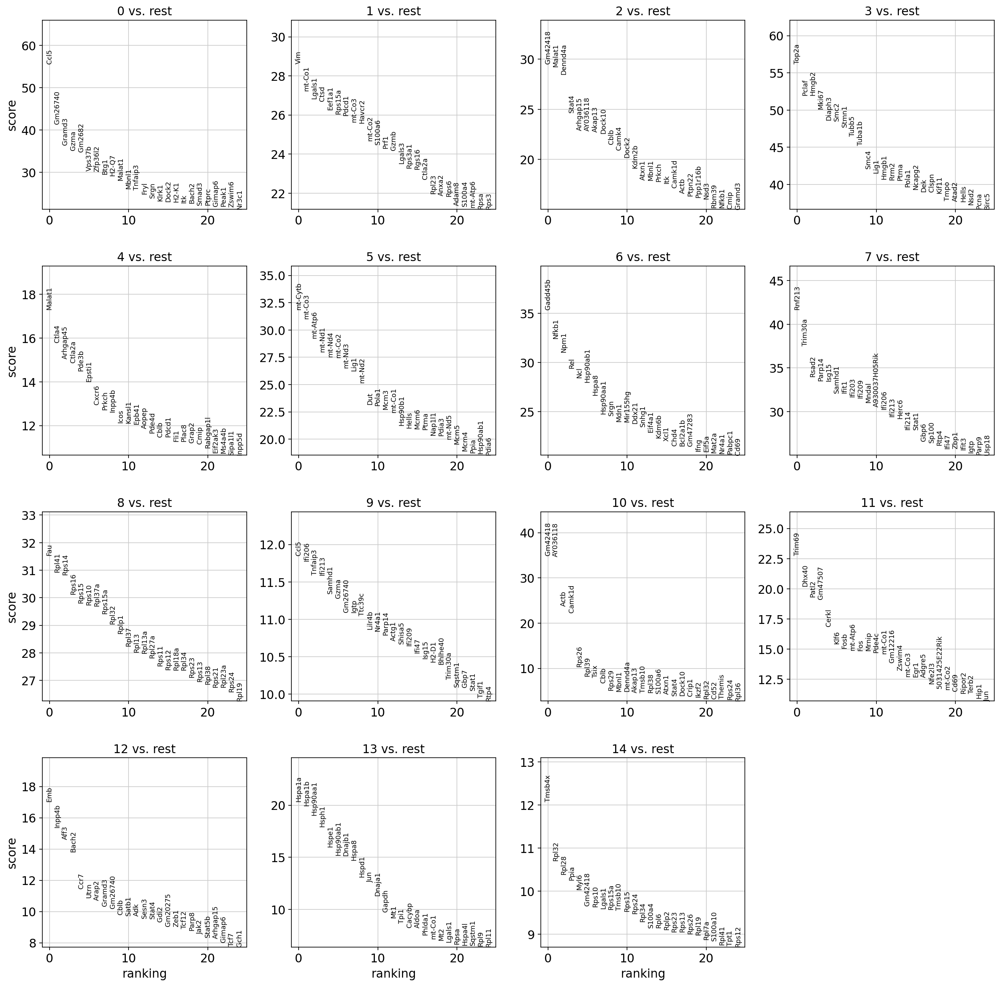

In [ ]:
sc.tl.rank_genes_groups(adata, 'leiden', method='wilcoxon',reference='rest',groups='all')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


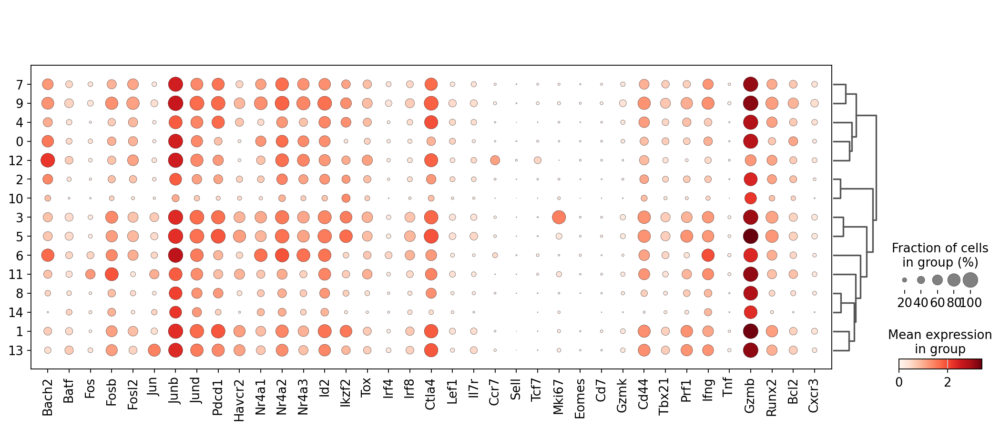

In [ ]:
# dotplot
sc.tl.dendrogram(adata,groupby = 'leiden', use_rep = 'X_sca')
sc.pl.dotplot(adata, var_names = [
    'Bach2', 'Batf', 'Fos','Fosb','Fosl2', 'Jun','Junb','Jund',
    'Pdcd1', 'Havcr2', 'Nr4a1', 'Nr4a2', 'Nr4a3', 'Id2','Ikzf2',
    'Tox',
    'Irf4','Irf8',
    'Ctla4',
    'Lef1',   'Il7r',    'Ccr7',    'Sell',
    'Tcf7',
    'Mki67',
    'Eomes', 'Cd7', 'Gzmk', 'Cd44',
    'Tbx21',
    'Prf1','Ifng', 'Tnf', 'Gzmb',
    'Runx2',
    'Bcl2','Cxcr3'


], groupby = 'leiden',
             dendrogram = True)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


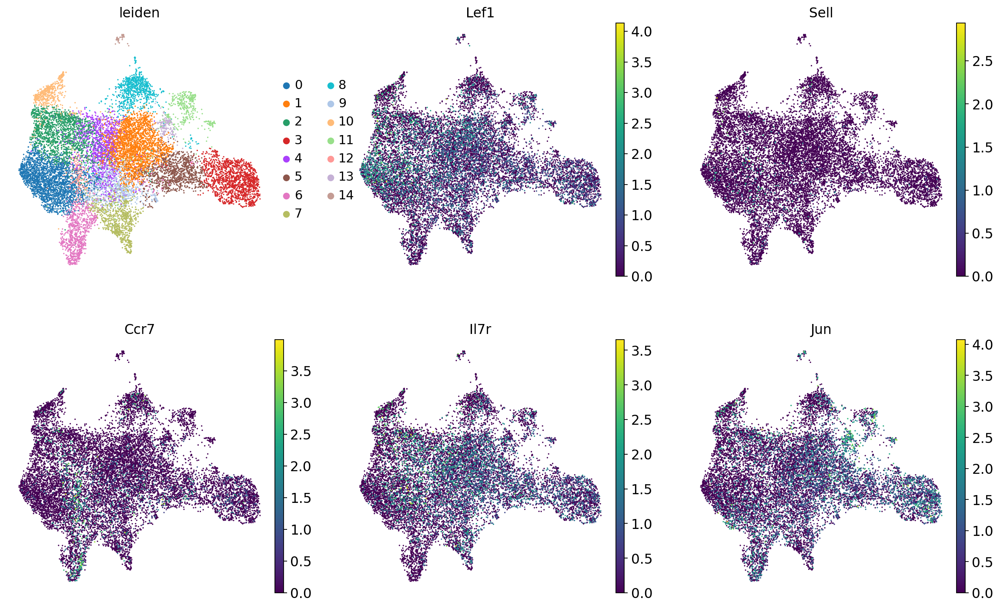

In [ ]:
# Naive
sc.pl.umap(adata, color = ['leiden', #'clusters',
                           'Lef1','Sell','Ccr7','Il7r',
                           'Jun'],use_raw=True, ncols = 3)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


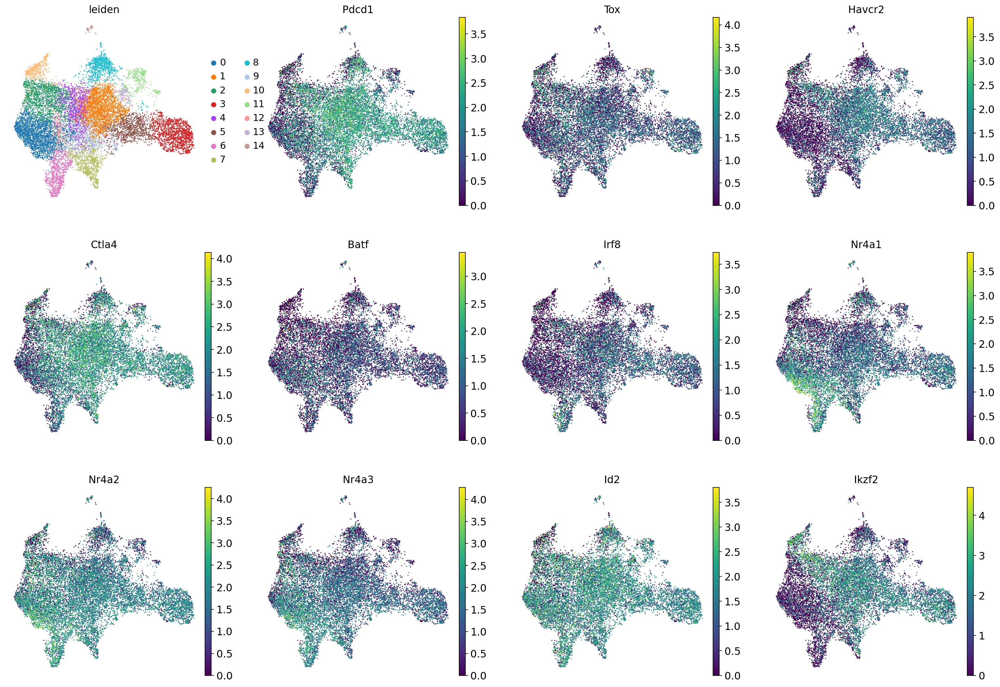

In [ ]:
# Exhaustion and inhibitory
sc.pl.umap(adata, color = ['leiden',#'clusters',
                           'Pdcd1','Tox','Havcr2',
                           'Ctla4','Batf','Irf8',
                           'Nr4a1','Nr4a2','Nr4a3',
                           'Id2','Ikzf2'
                          ],
           use_raw=True)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


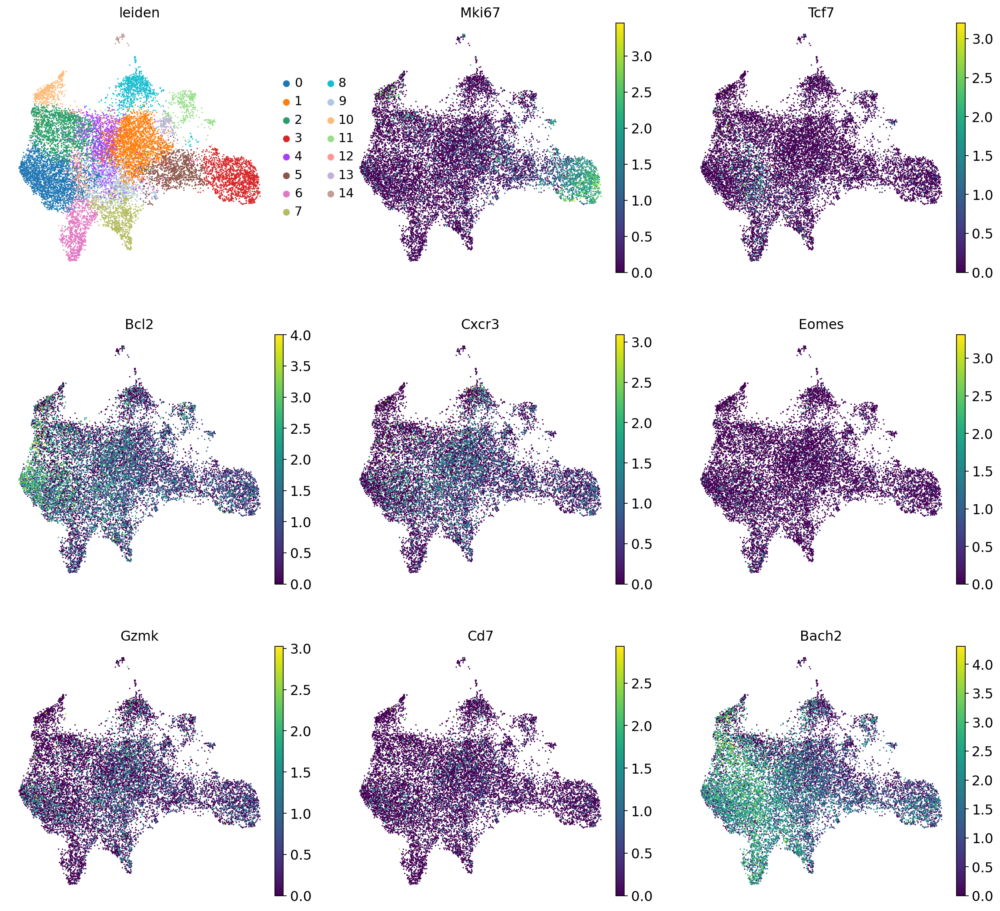

In [ ]:
# Plasticity, Self-renewal/memory and expansion
sc.pl.umap(adata, color = ['leiden', #'clusters',
                           'Mki67','Tcf7',
                           'Bcl2',
                           'Cxcr3',
                           'Eomes','Gzmk','Cd7',
                           'Bach2'
                          ],
           ncols=3,
           use_raw=True)

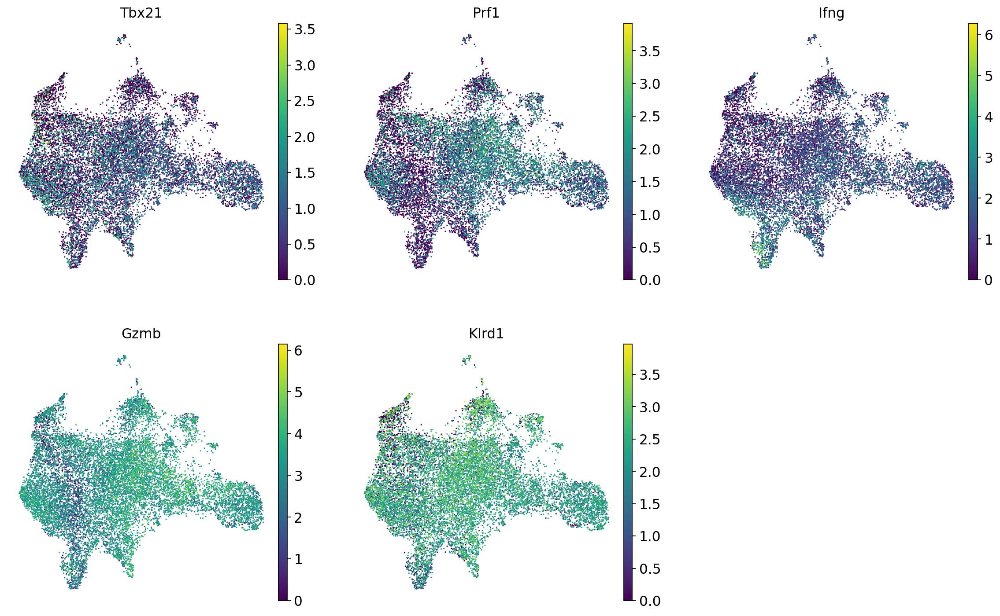

In [ ]:
# Cytotoxic
sc.pl.umap(adata, color = [#'clusters',
                           'Tbx21','Prf1','Ifng',
                           'Gzmb','Klrd1'],
           use_raw=True, ncols = 3)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


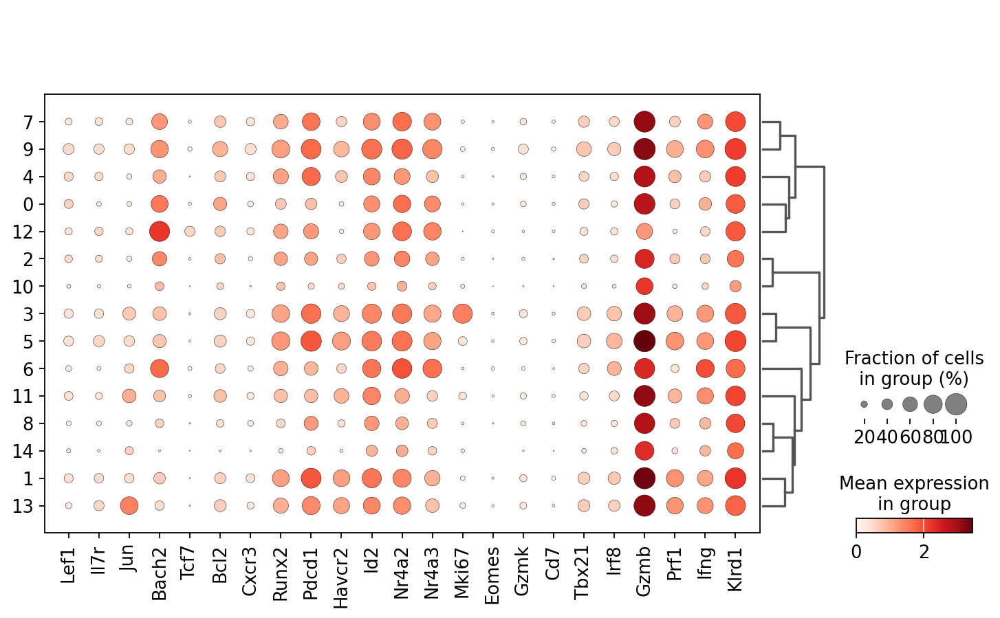

In [ ]:
sc.pl.dotplot(adata, var_names = [
                           'Lef1','Il7r',
                           'Jun','Bach2',
                           'Tcf7','Bcl2','Cxcr3',
                           'Runx2',
                           'Pdcd1','Havcr2','Id2',
                           'Nr4a2','Nr4a3',
                           'Mki67',
                           'Eomes','Gzmk','Cd7',
                           'Tbx21','Irf8','Gzmb','Prf1','Ifng','Klrd1'
                          ],
           dendrogram=True, groupby = "leiden") #,swap_axes = True)


In [ ]:
adata.write(os.path.join(work_dir, 'RNA/adata_SCA.h5ad'), compression='gzip')

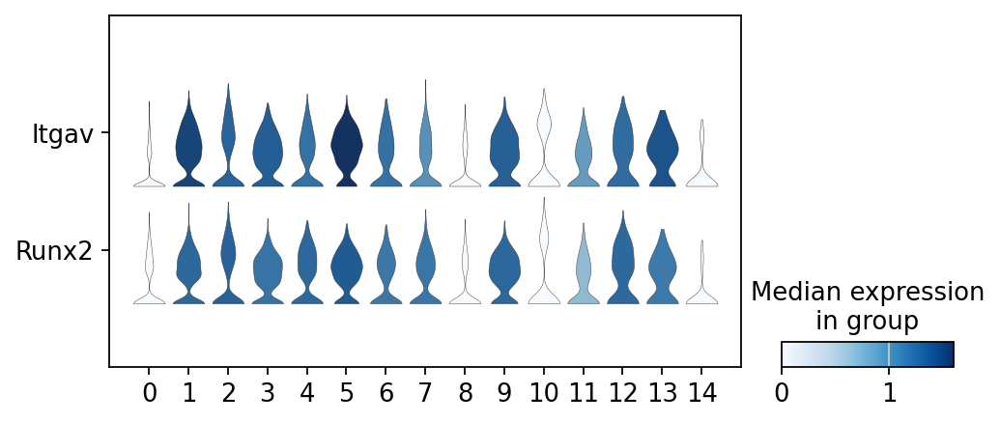

In [ ]:
sc.pl.stacked_violin(adata, var_names = ['Itgav','Runx2'], groupby = 'leiden',
                         log=False,
                         title=None,
                         colorbar_title='Median expression\nin group',
                         figsize=[7,3],
                         jitter=False,
                         scale='width',
                         swap_axes=True,
                         save='Itgav_Runx2_violin.pdf',
                         return_fig=False,
                         cmap='Blues',
                         ax=None,
                         vmin=None,
                         vmax=None,
                         vcenter=None)

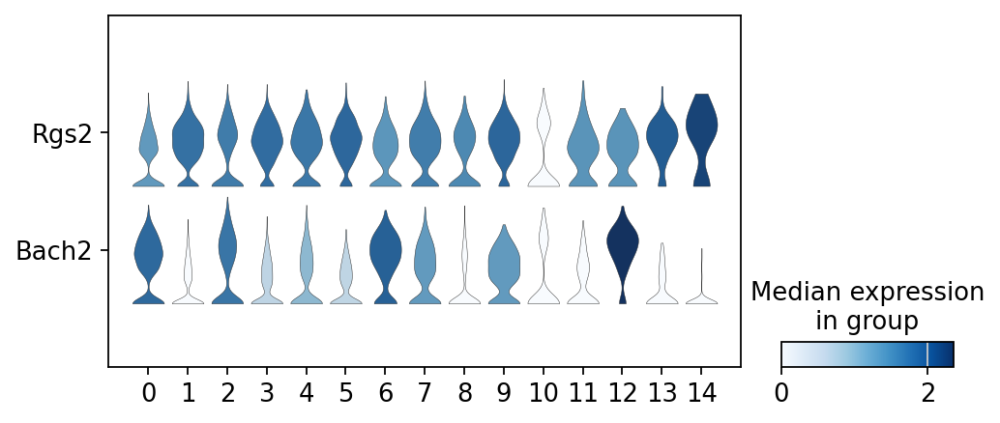

In [ ]:
sc.pl.stacked_violin(adata, var_names = ['Rgs2','Bach2'], groupby = 'leiden',
                         log=False,
                         title=None,
                         colorbar_title='Median expression\nin group',
                         figsize=[7,3],
                         jitter=False,
                         scale='width',
                         swap_axes=True,
                         save='Rgs2_Bach2_violin.pdf',
                         return_fig=False,
                         cmap='Blues',
                         ax=None,
                         vmin=None,
                         vmax=None,
                         vcenter=None)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


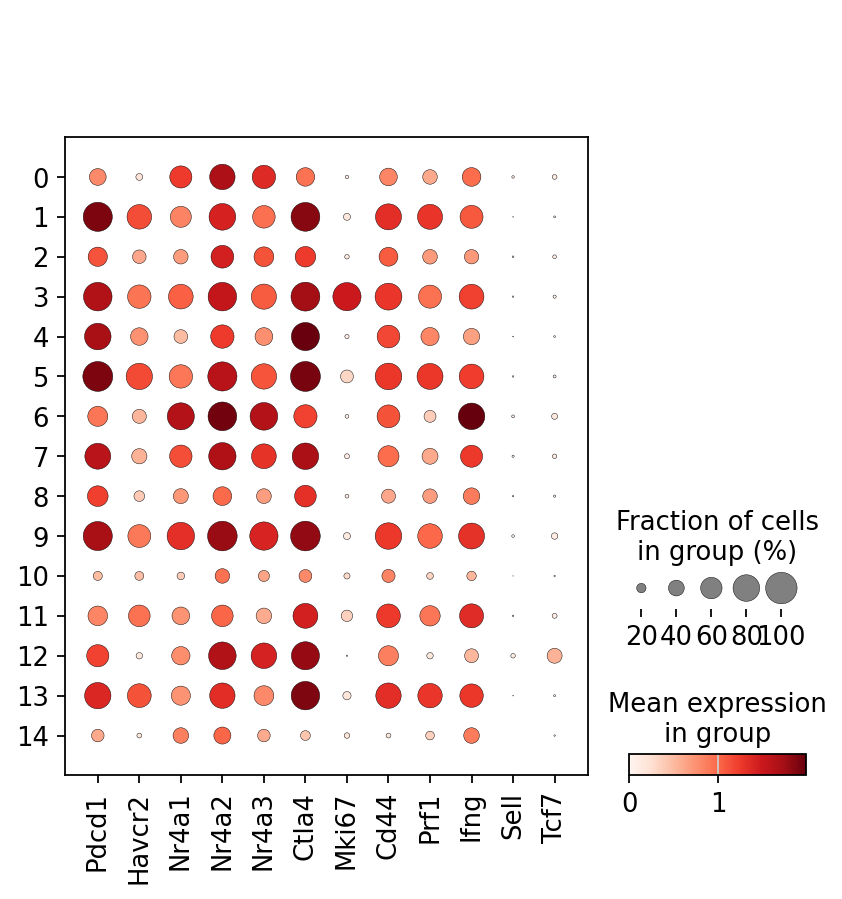

In [ ]:
sc.pl.dotplot(adata, var_names = [
     'Pdcd1', 'Havcr2', 'Nr4a1', 'Nr4a2', 'Nr4a3',
    'Ctla4',
    'Mki67',
     'Cd44',
    'Prf1','Ifng',
    'Sell','Tcf7'
], groupby = 'leiden',
             dendrogram = False)

/home/devoes/miniconda3/envs/SCENICplus_SCA/lib/python3.10/site-packages/scanpy/plotting/_dotplot.py:748: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  dot_ax.scatter(x, y, **kwds)


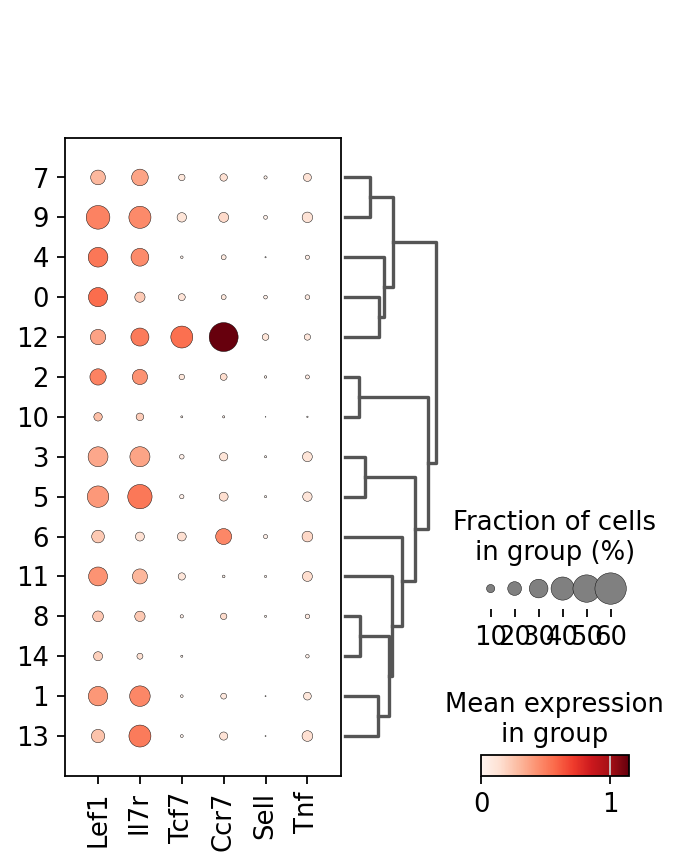

In [ ]:
sc.pl.dotplot(adata, var_names = [
  'Lef1',   'Il7r',  'Tcf7',  'Ccr7',    'Sell', 'Tnf'
], groupby = 'leiden',
             dendrogram = True)
